In [201]:
import rasterio as rio
from rasterio.plot import show
import geopandas as gpd
from glob import glob
import numpy as np
import matplotlib.pyplot as plt
import folium
import os, sys
import fnmatch
from TOA_reflectance_stacker import histogram_stretch
from tqdm import tqdm
import earthpy.plot as ep
import shapely
from sklearn import cluster
from rasterio.plot import reshape_as_image
import matplotlib.patches as mpatches
from datetime import datetime

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


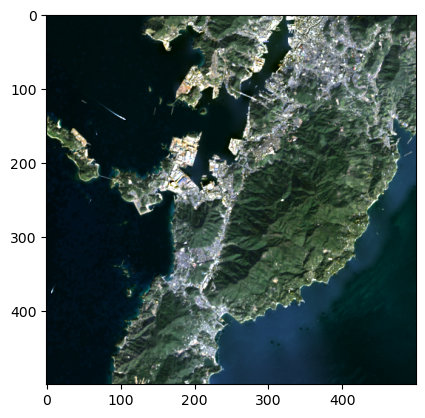

<Axes: >

In [11]:
# Basic unsupervised machine learning
# Select an initial training area

with rio.open("LC08_L2SP_113037_20210104_20210308_02_T1/LC08_L2SP_113037_20210104_20210308_02_T1_STACKED.tif") as src:
    profile = src.profile
    stack = src.read()
    src.close()



In [24]:
# Now we need to reshape the data so that we get columns of reflectances for each pixel (row)

# This helped me a lot:
# https://stackoverflow.com/questions/35226115/numpy-reshaping-multdimensional-array-through-arbitrary-axis

# EXAMPLE: 
# This is a 3 band 2x4 image
# test = np.arange(24).reshape(3,2,4)

# print(test)
# [[[ 0  1  2  3]
#   [ 4  5  6  7]]

#  [[ 8  9 10 11]
#   [12 13 14 15]]

#  [[16 17 18 19]
#   [20 21 22 23]]]

# For pixel 1, the values are 0, 8, 16
# We have to make sure that 0,8,16 are close together so that they can be reshaped properly

# We can use swapaxes to swap the bands and the columns - flatten will then give us the desired result
# test.swapaxes(0, 2)
#       [[[ 0,  8, 16],
#         [ 4, 12, 20]],

#        [[ 1,  9, 17],
#         [ 5, 13, 21]],

#        [[ 2, 10, 18],
#         [ 6, 14, 22]],

#        [[ 3, 11, 19],
#         [ 7, 15, 23]]]

training = scaled_stack[:, 1500:2000, 750:1250]

new_shape = (training.shape[1] * training.shape[2], training.shape[0])

X = training.swapaxes(0,2).reshape(new_shape)

# 250,000 pixels (rows), 8 bands (columns) 
print(X.shape)
X

(250000, 8)


array([[ 2.64750000e-03,  5.59000000e-03,  6.69000000e-03, ...,
         5.70000000e-03,  5.92000000e-03,  2.89128566e+02],
       [ 2.23500000e-03,  5.09500000e-03,  6.63500000e-03, ...,
         5.75500000e-03,  5.92000000e-03,  2.89125148e+02],
       [ 1.05250000e-03,  5.70000000e-03,  6.30500000e-03, ...,
         5.61750000e-03,  5.53500000e-03,  2.89128566e+02],
       ...,
       [-1.61500000e-03,  7.32250000e-03,  9.19250000e-03, ...,
         6.44250000e-03,  7.15750000e-03,  2.88325331e+02],
       [-9.82500000e-04,  8.14750000e-03,  9.63250000e-03, ...,
         7.04750000e-03,  7.32250000e-03,  2.88352675e+02],
       [-1.36750000e-03,  8.31250000e-03,  1.02375000e-02, ...,
         7.13000000e-03,  7.40500000e-03,  2.88362929e+02]])

In [26]:
# Because kmeans uses distances to identify clusters, we need to scale the data (specifically, we want to scale the temperature
# data, because it has a completely different scale compared to the reflectances)
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

X_scaled

array([[-0.70983575, -0.84502814, -0.88548296, ..., -0.83263182,
        -0.73929873,  1.033179  ],
       [-0.73225009, -0.87011268, -0.88755919, ..., -0.83181178,
        -0.73929873,  1.03214058],
       [-0.79650452, -0.83945379, -0.90001655, ..., -0.83386188,
        -0.74816988,  1.033179  ],
       ...,
       [-0.94145056, -0.75723222, -0.79101464, ..., -0.82156124,
        -0.71078433,  0.78915173],
       [-0.90708191, -0.71542465, -0.77440483, ..., -0.81254077,
        -0.70698241,  0.79745904],
       [-0.92800196, -0.70706313, -0.75156633, ..., -0.8113107 ,
        -0.70508145,  0.80057429]])

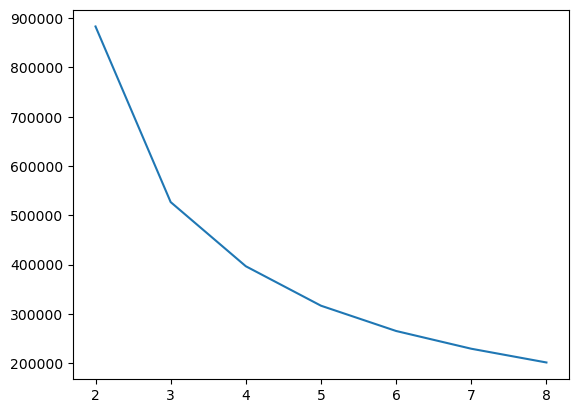

CPU times: total: 46.9 s
Wall time: 7.08 s


In [29]:
%%time
### Do a basic elbow plot to try and find the best number of clusters

inertia = np.empty(7)
num_clusters = [i for i in range(2,9)]

for i, number in enumerate(num_clusters):
    k_means = cluster.KMeans(n_clusters = number, random_state = 42, n_init = 10) # default clusters is 8
    k_means.fit(X_scaled)
    inertia[i] = k_means.inertia_

# Elbow plot suggests that n_clusters = 3 or 4 is a good choice
plt.plot(num_clusters, inertia)
plt.show()

C:\Users\tranq\anaconda3\envs\gdal\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


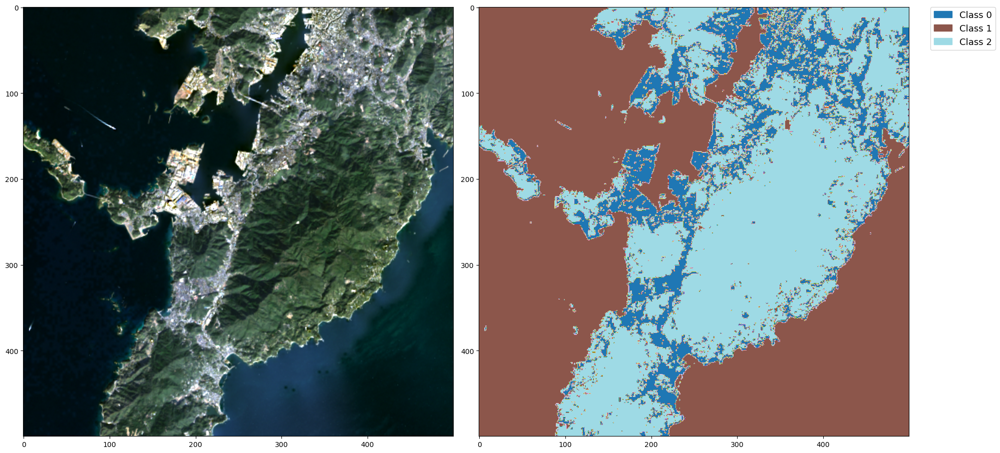

In [37]:
# Three clusters
k_means3 = cluster.KMeans(n_clusters = 3, random_state = 42) # default clusters is 8
k_means3.fit(X_scaled)

# Labels for each pixel
X_cluster = k_means3.labels_

# Reshape into a proper coordinate grid
# Note that you have to transpose the X_cluster because of the swapaxes shenanigans we used earlier
X_cluster = X_cluster.reshape(500,500).T

# Plot results - relatively effective, correctly identified forests/urban/water
fig, ax = plt.subplots(1,2, figsize = (20,10))

i = ax[1].imshow(X_cluster, cmap="tab20")

show(stretch_tcc_studyarea, ax = ax[0])

ep.draw_legend(im_ax = i, titles = [f"Class {num}" for num in range(3)], cmap = "tab20")

plt.tight_layout()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


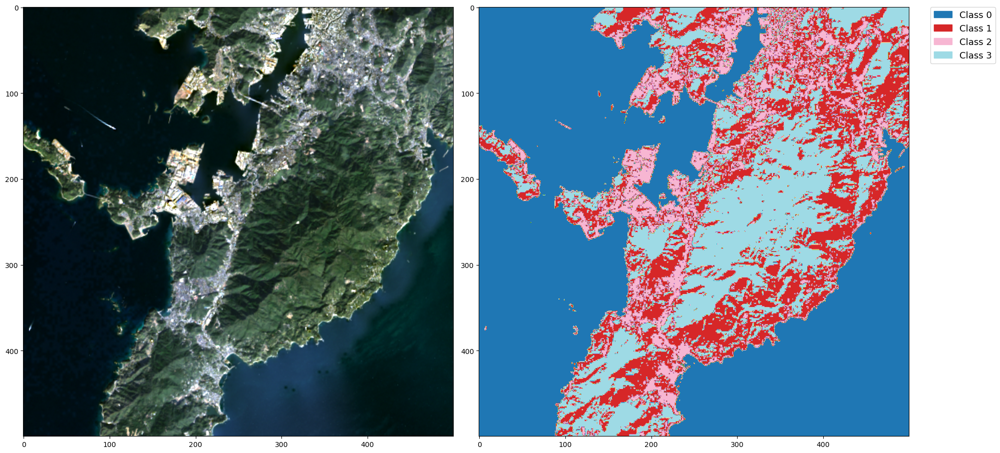

In [38]:
# Four clusters
k_means4 = cluster.KMeans(n_clusters = 4, random_state = 42, n_init = 10) # default clusters is 8
k_means4.fit(X_scaled)

# Labels for each pixel
X_cluster = k_means4.labels_

# Reshape into a proper coordinate grid
X_cluster = X_cluster.reshape(500,500).T

# Plot results - seems to have identified different types of trees? There are cases where different trees grow on different
# sides of a hill
fig, ax = plt.subplots(1,2, figsize = (20,10))

i = ax[1].imshow(X_cluster, cmap="tab20")

show(stretch_tcc_studyarea, ax = ax[0])

ep.draw_legend(im_ax = i, titles = [f"Class {num}" for num in range(4)], cmap = "tab20")

plt.tight_layout()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


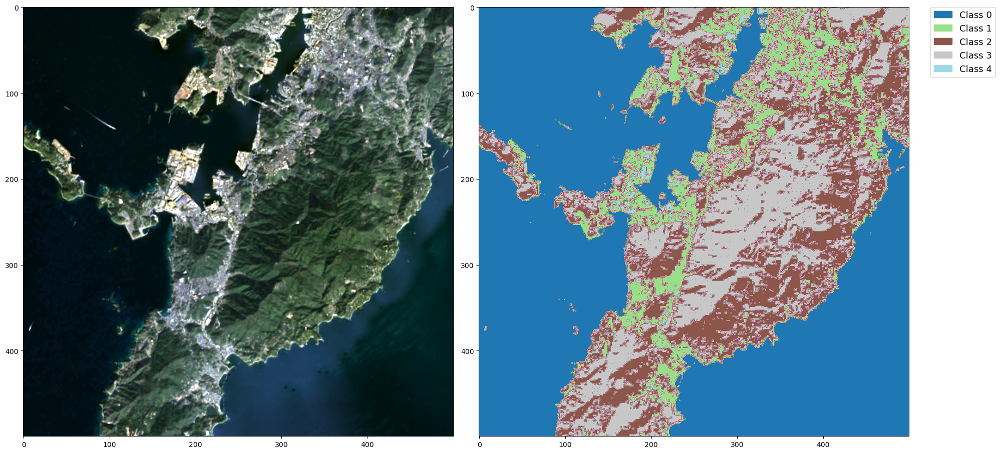

In [49]:
# Five clusters
k_means5 = cluster.KMeans(n_clusters = 5, random_state = 42, n_init = 10) # default clusters is 8
k_means5.fit(X_scaled)

# Labels for each pixel
X_cluster = k_means5.labels_

# Reshape into a proper coordinate grid
X_cluster = X_cluster.reshape(500,500).T

# Plot results - appears to have identified both tree types as well as bare land.
fig, ax = plt.subplots(1,2, figsize = (20,10))

i = ax[1].imshow(X_cluster, cmap="tab20")

show(stretch_tcc_studyarea, ax = ax[0])

ep.draw_legend(im_ax = i, titles = [f"Class {num}" for num in range(5)], cmap = "tab20")

plt.tight_layout()

In [70]:
# Prepare a dictionary for the above classes
landuse_map = {
    1: "Water", 
    2: "Urban",
    3: "Forest 1",
    4: "Forest 2",
    5: "Bare Land"
}

from matplotlib.colors import ListedColormap

# Set up dictionary for color map
colors = dict((
    (0, "blue"),   
    (1, "grey"),   # Water 
    (2, "xkcd:lime green"),      # Cropland 
    (3, "green"),    # Forest 
    (4, "brown")
))

cmap = ListedColormap([colors[key] for key in colors], name = "LULC")

In [52]:
# The five cluster model looks quite good - let's what happens if we extend it to the entire dataset
new_shape = (scaled_stack.shape[1] * scaled_stack.shape[2], scaled_stack.shape[0])

X_test = scaled_stack.swapaxes(0,2).reshape(new_shape)

# Note that you don't fit the scaler
X_test_scaled = scaler.transform(X_test)

print(X_test_scaled.shape)
X_test_scaled

(6693912, 8)


array([[-0.81742457, -0.79207187, -0.87406372, ..., -0.84780261,
        -0.73993239,  0.85353339],
       [-0.79501023, -0.79207187, -0.88444485, ..., -0.8379621 ,
        -0.7519718 ,  0.85561022],
       [-0.75914729, -0.78649753, -0.87198749, ..., -0.8379621 ,
        -0.74626892,  0.85768705],
       ...,
       [ 1.38366329,  1.05303587,  1.20008687, ...,  1.83168746,
         1.57480376, -0.72900937],
       [ 1.45688345,  1.11296007,  1.16998158, ...,  1.71688146,
         1.67682197, -0.71031792],
       [ 2.14126786,  1.89615535,  1.66827601, ...,  1.72016163,
         1.95182758, -0.77885323]])

In [44]:
# Prep full scale image
stretch_tcc = histogram_stretch(scaled_stack[[3,2,1]])

In [56]:
%%time
# labels for each pixel
X_test_cluster = k_means5.predict(X_test_scaled)

# Reshape into a proper coordinate grid
X_test_cluster = X_test_cluster.reshape(scaled_stack.shape[2],scaled_stack.shape[1]).T

CPU times: total: 250 ms
Wall time: 106 ms


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


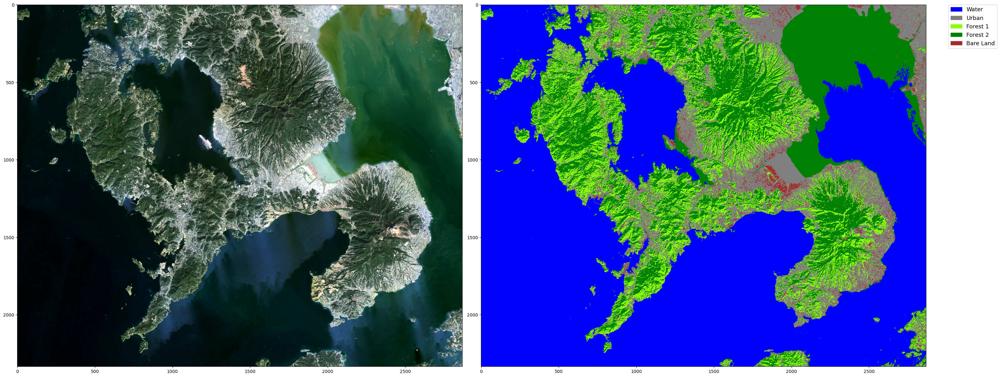

In [71]:
# Plot results - it is clear there are some issues with identifying sediments in water - depending on your use case, 
# this may not be an issue

# In addition, must remember that LANDSAT Level 2 products generally have issues with water reflectances

# Other than that, it appears to be reasonably successful at identifying land use
fig, ax = plt.subplots(1,2, figsize = (32,18))

i = ax[1].imshow(X_test_cluster, cmap=cmap, interpolation = "nearest")

show(stretch_tcc, ax = ax[0])

ep.draw_legend(im_ax = i, titles = [landuse_map[num] for num in range(1,6)], cmap = cmap)

plt.tight_layout()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


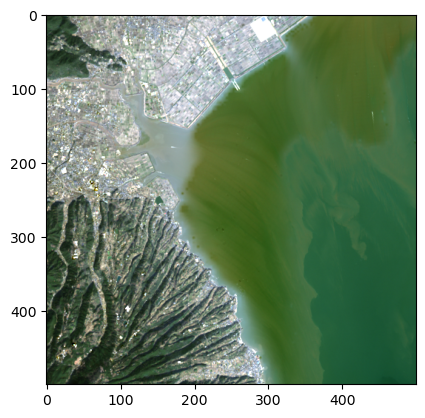

<Axes: >

In [72]:
# It's important to note that the initial study area has a significant effect on the final result
# let's choose a different training area

# Conduct a histogram stretch of the study area
stretch_tcc_newstudyarea = histogram_stretch(scaled_stack[[3,2,1], 0:500, 1750:2250])

# View the chosen study area
show(stretch_tcc_newstudyarea)

In [73]:
training = scaled_stack[:, 0:500, 1750:2250]

new_shape = (training.shape[1] * training.shape[2], training.shape[0])

X = training.swapaxes(0,2).reshape(new_shape)

# 250,000 pixels (rows), 8 bands (columns) 
print(X.shape)
X

(250000, 8)


array([[9.68750000e-03, 1.20250000e-02, 2.43450000e-02, ...,
        5.39075000e-02, 2.53350000e-02, 2.78542958e+02],
       [1.10900000e-02, 1.34825000e-02, 2.41525000e-02, ...,
        5.28625000e-02, 2.46200000e-02, 2.78440417e+02],
       [1.33450000e-02, 1.60675000e-02, 2.72600000e-02, ...,
        7.37900000e-02, 3.24025000e-02, 2.78245590e+02],
       ...,
       [5.39750000e-03, 1.98900000e-02, 3.94975000e-02, ...,
        3.91250000e-03, 5.20500000e-03, 2.83109433e+02],
       [5.34250000e-03, 1.93400000e-02, 3.89200000e-02, ...,
        3.91250000e-03, 4.82000000e-03, 2.83116269e+02],
       [5.28750000e-03, 1.95325000e-02, 3.89200000e-02, ...,
        3.91250000e-03, 4.60000000e-03, 2.83136777e+02]])

In [88]:
# In addition, let's create a pipeline for our unsupervised learning workflow
from sklearn.pipeline import make_pipeline

pipeline = make_pipeline(StandardScaler(), cluster.KMeans(n_clusters = 5, n_init = 10))

pipeline

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('kmeans', KMeans(n_clusters=5, n_init=10))])

In [89]:
# Get the predicted labels for the new training area
X_cluster = pipeline.fit_predict(X)

# Reshape into a proper coordinate grid
X_cluster = X_cluster.reshape(500,500).T

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


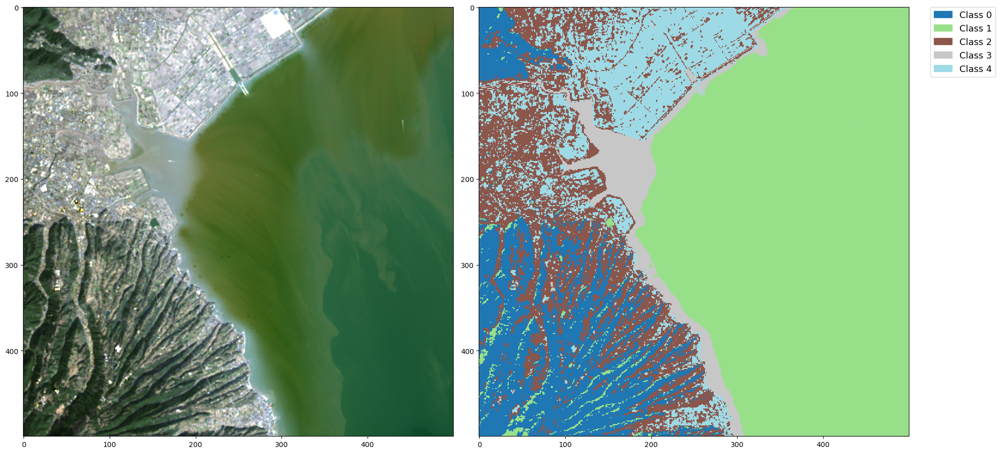

In [95]:
# Plot results - This looks to more clearly identify sediment-laden water rather than different types of forest
fig, ax = plt.subplots(1,2, figsize = (20,10))

i = ax[1].imshow(X_cluster, cmap="tab20", interpolation = "nearest")

show(stretch_tcc_newstudyarea, ax = ax[0])

ep.draw_legend(im_ax = i, titles = [f"Class {num}" for num in range(5)], cmap = "tab20")

plt.tight_layout()

In [96]:
# Prepare a dictionary for the above classes
landuse_map = {
    1: "Forest", 
    2: "Water",
    3: "Urban",
    4: "Sediment-Water",
    5: "Cropland"
}

from matplotlib.colors import ListedColormap

# Set up dictionary for color map
colors = dict((
    (1, "green"),   
    (2, "blue"),   
    (3, "grey"),     
    (4, "xkcd:turquoise"),
    (5, "brown")
))

cmap = ListedColormap([colors[key] for key in colors], name = "LULC")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


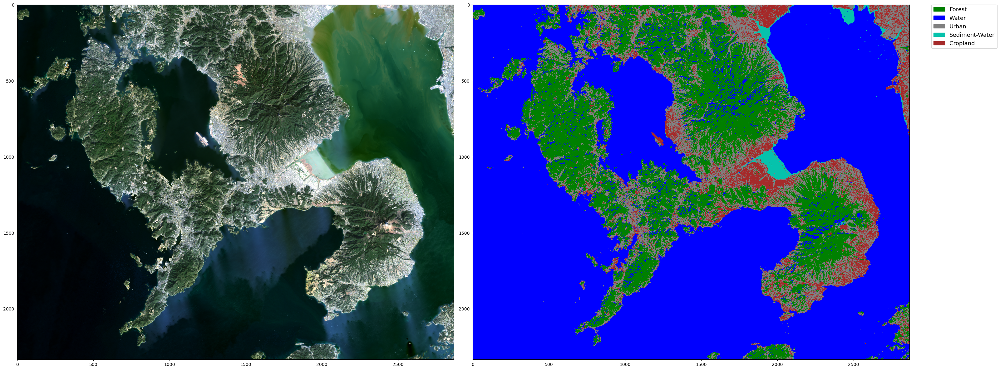

In [97]:
# Get the predicted labels for the new training area
X_test_cluster = pipeline.predict(X_test)

# Reshape into a proper coordinate grid
X_test_cluster = X_test_cluster.reshape(scaled_stack.shape[2],scaled_stack.shape[1]).T


# Plot results - now it is clear that the issue is with forested areas - some of the forested areas (e.g., the different 
# types of vegetation) are now misclassified as water
fig, ax = plt.subplots(1,2, figsize = (32,18))

i = ax[1].imshow(X_test_cluster, cmap=cmap, interpolation = "nearest")

show(stretch_tcc, ax = ax[0])

ep.draw_legend(im_ax = i, titles = [landuse_map[num] for num in range(1,6)], cmap = cmap)

plt.tight_layout()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


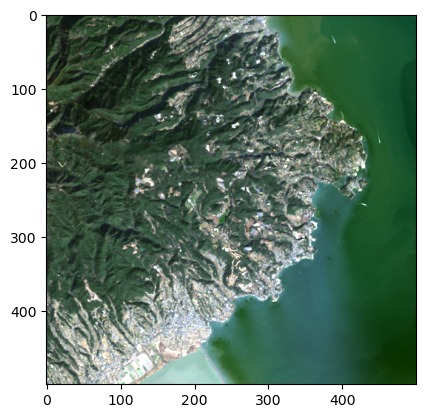

<Axes: >

In [98]:
# Thus, its clear we need an area that has as many different types of land-use as possible. 
# Conduct a histogram stretch of the study area
stretch_tcc_newstudyarea = histogram_stretch(scaled_stack[[3,2,1], 500:1000, 1750:2250])

# View the chosen study area
show(stretch_tcc_newstudyarea)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


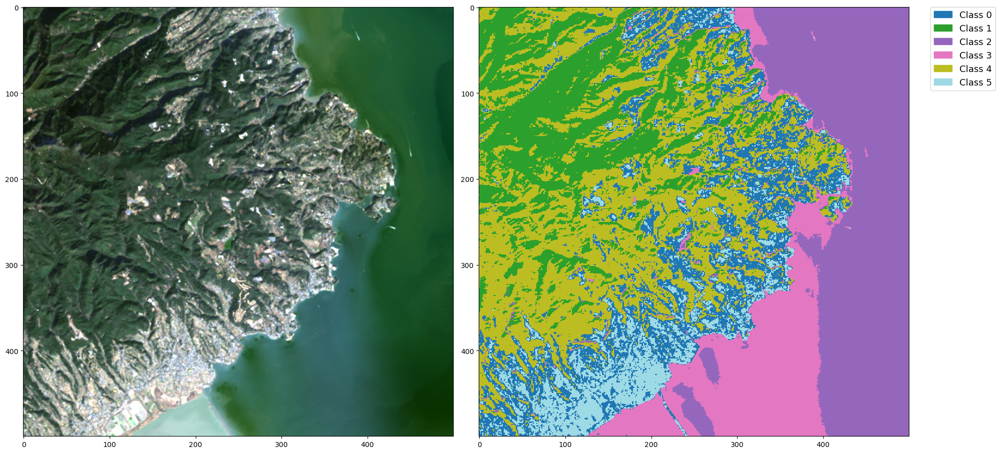

In [103]:
training = scaled_stack[:, 500:1000, 1750:2250]

new_shape = (training.shape[1] * training.shape[2], training.shape[0])

X = training.swapaxes(0,2).reshape(new_shape)

pipeline6 = make_pipeline(StandardScaler(), cluster.KMeans(n_clusters = 6, n_init = 10))

X_cluster = pipeline6.fit_predict(X)

# Reshape into a proper coordinate grid
X_cluster = X_cluster.reshape(500,500).T

# Plot results - This looks to more clearly identify sediment-laden water rather than different types of forest
fig, ax = plt.subplots(1,2, figsize = (20,10))

i = ax[1].imshow(X_cluster, cmap="tab20", interpolation = "nearest")

show(stretch_tcc_newstudyarea, ax = ax[0])

ep.draw_legend(im_ax = i, titles = [f"Class {num}" for num in range(6)], cmap = "tab20")

plt.tight_layout()

In [120]:
# Prepare a dictionary for the above classes
landuse_map = {
    3: "Water",
    4: "Sediment-Water",
    2: "Forest 1",
    5: "Forest 2",
    6: "Urban",
    1: "Cropland"
}

from matplotlib.colors import ListedColormap

# Set up dictionary for the legend
colors = dict((
    (1, "blue"),   
    (2, "xkcd:turquoise"),   
    (3, "green"),     
    (4, "xkcd:lime green"),
    (5, "grey"),
    (6, "brown")
))

legend_cmap = ListedColormap([colors[key] for key in colors], name = "LULC")

# Set up dictionary for color map
colors = dict((
    (1, "brown"),   
    (2, "green"),   
    (3, "blue"),     
    (4, "xkcd:turquoise"),
    (5, "xkcd:lime green"),
    (6, "grey")
))

map_cmap = ListedColormap([colors[key] for key in colors], name = "LULC")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


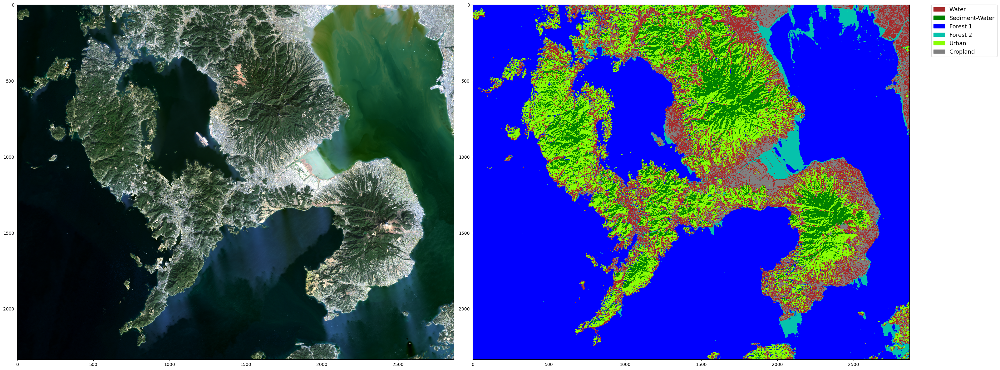

In [114]:
# Get the predicted labels for the new training area
X_test_cluster = pipeline6.predict(X_test)

# Reshape into a proper coordinate grid
X_test_cluster = X_test_cluster.reshape(scaled_stack.shape[2],scaled_stack.shape[1]).T


# Plot results - very nice! this captures all of the elements that we identified. If you wanted to, you could convert 
# sediment-water into 
fig, ax = plt.subplots(1,2, figsize = (32,18))

i = ax[1].imshow(X_test_cluster, cmap = map_cmap, interpolation = "nearest")

show(stretch_tcc, ax = ax[0])

ep.draw_legend(im_ax = i, titles = [landuse_map[key] for key in landuse_map.keys()], cmap = legend_cmap)

plt.tight_layout()

In [118]:
# Run a conservative cloud detection
def qa_pixel_interp_conservative(number):
    '''
    Helps interpret the 16bit data in the landsat qa pixels
    
    returns True if there is mid confidence cirrus, snow/ice, cloud shadow, OR clouds
    '''
    binary = bin(number)[2:].zfill(16)
    
    # if high confidence cirrus, snow/ice, cloud shadow, and clouds
    # 01 - low, 10 - medium, 11 - high
    if int(binary[:2]) > 10:
        return True
    elif int(binary[2:4]) > 10:
        return True
    elif int(binary[4:6]) > 10:
        return True
    elif int(binary[6:8]) > 10:
        return True
    else:
        return False

def apply_array_func(func, x):
    '''
    Applies a function element-wise across a 1D array
    '''
    return np.array([func(xi) for xi in x])

  0%|                                                                                            | 0/7 [00:00<?, ?it/s]

Generating Land Use for LC08_L2SP_113037_20210104_20210308_02_T1


 14%|████████████                                                                        | 1/7 [00:05<00:35,  5.83s/it]

Generating Land Use for LC08_L2SP_113037_20210120_20210307_02_T1


 29%|████████████████████████                                                            | 2/7 [00:13<00:34,  6.89s/it]

Generating Land Use for LC08_L2SP_113037_20210221_20210303_02_T1


 43%|████████████████████████████████████                                                | 3/7 [00:19<00:25,  6.47s/it]

Generating Land Use for LC08_L2SP_113037_20210325_20210402_02_T1


 57%|████████████████████████████████████████████████                                    | 4/7 [00:25<00:18,  6.21s/it]

Generating Land Use for LC08_L2SP_113037_20211003_20211013_02_T1


 71%|████████████████████████████████████████████████████████████                        | 5/7 [00:31<00:12,  6.40s/it]

Generating Land Use for LC08_L2SP_113037_20211120_20211130_02_T1


 86%|████████████████████████████████████████████████████████████████████████            | 6/7 [00:41<00:07,  7.58s/it]

Generating Land Use for LC08_L2SP_113037_20211222_20211230_02_T1


100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:47<00:00,  6.73s/it]


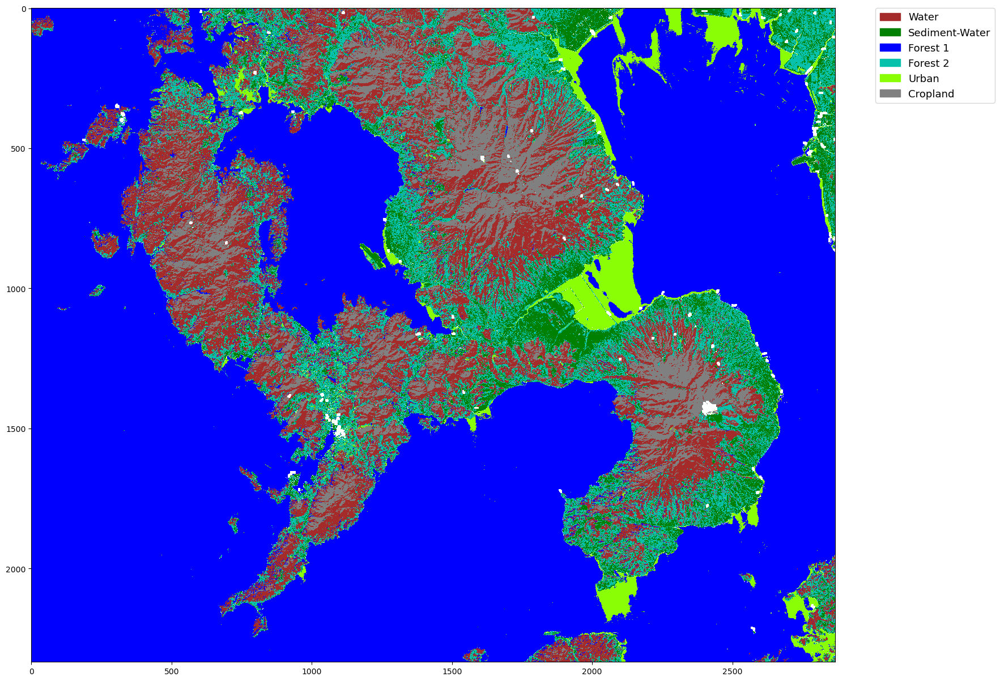

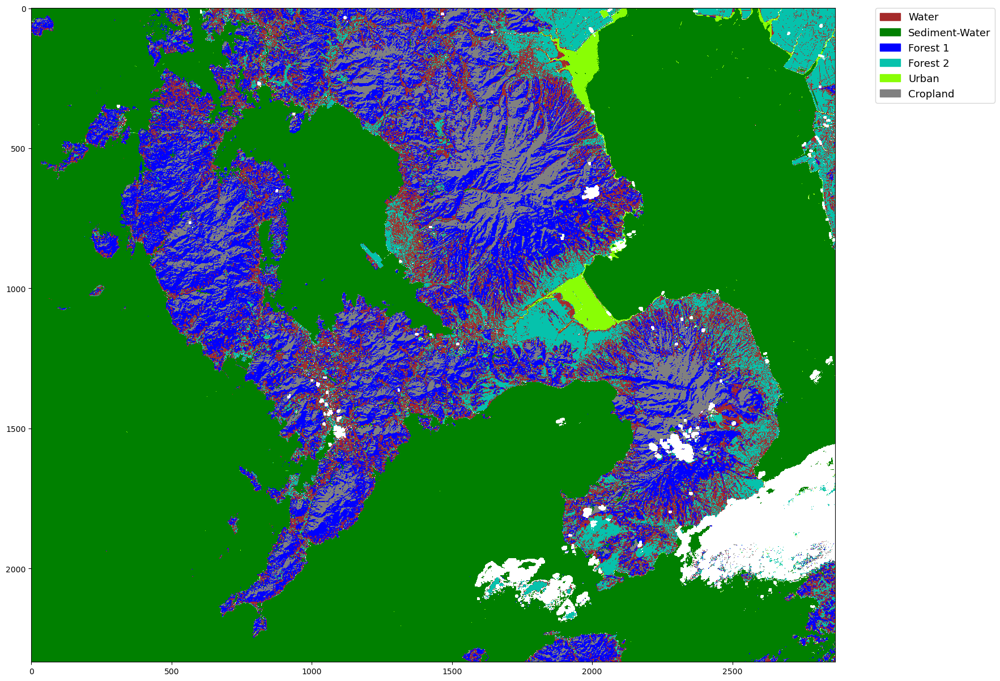

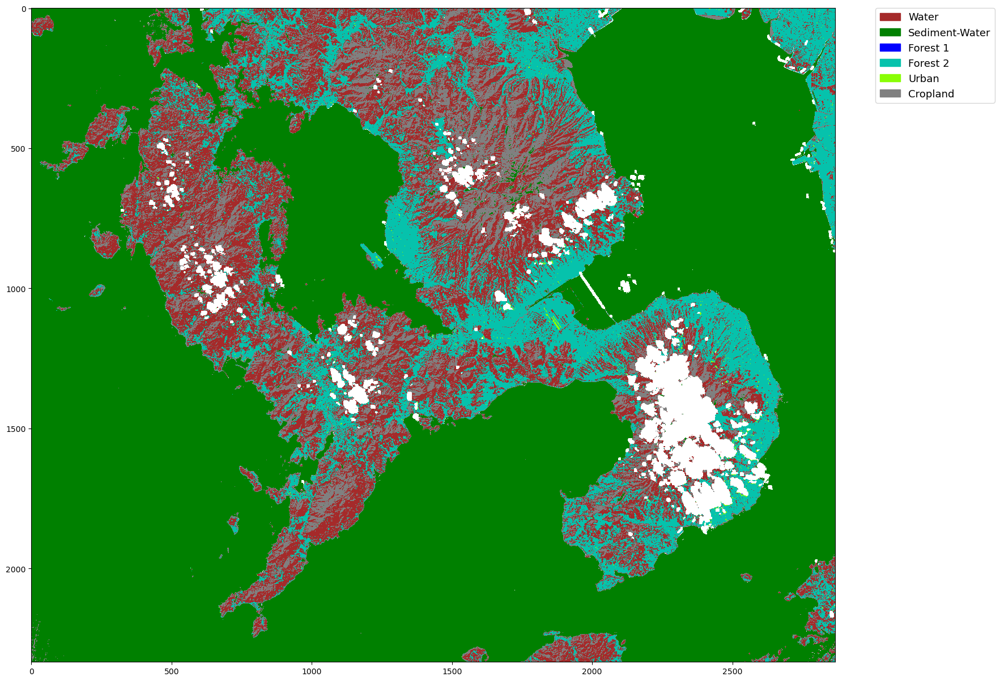

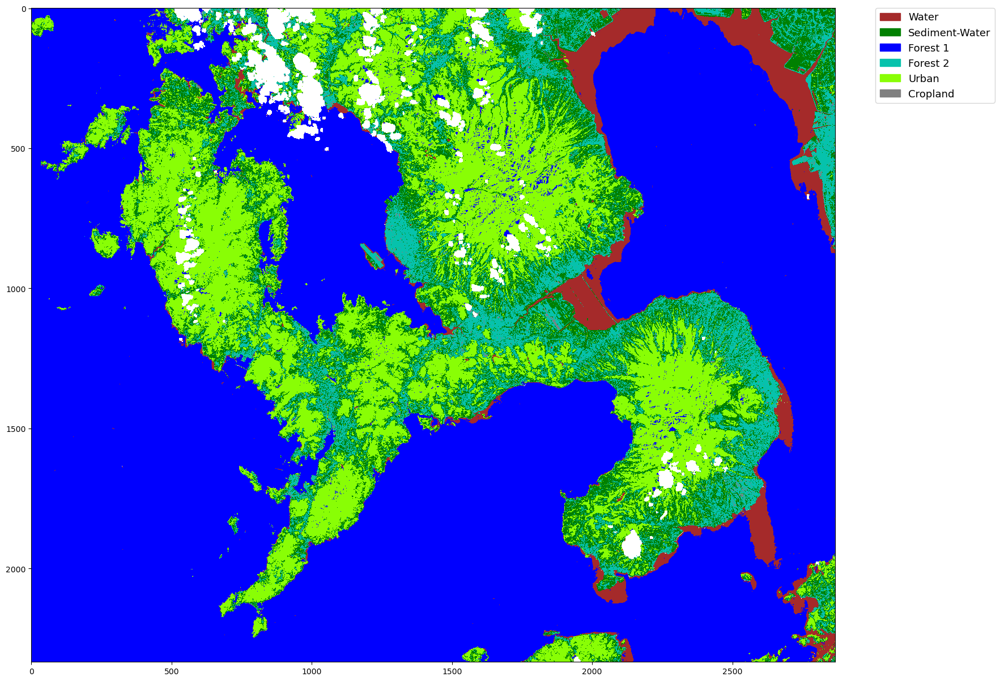

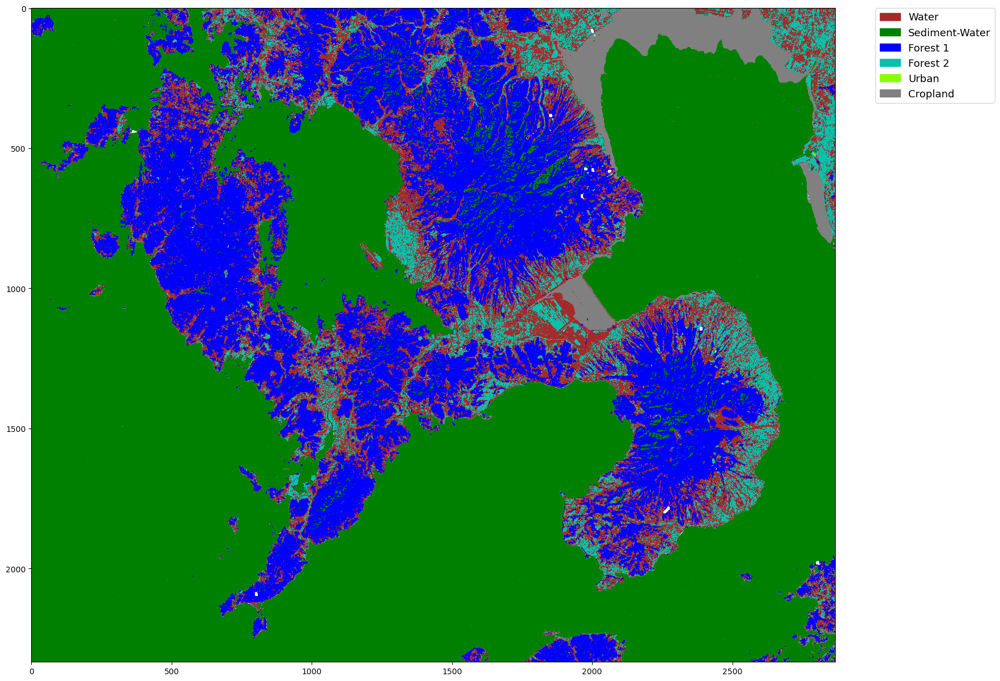

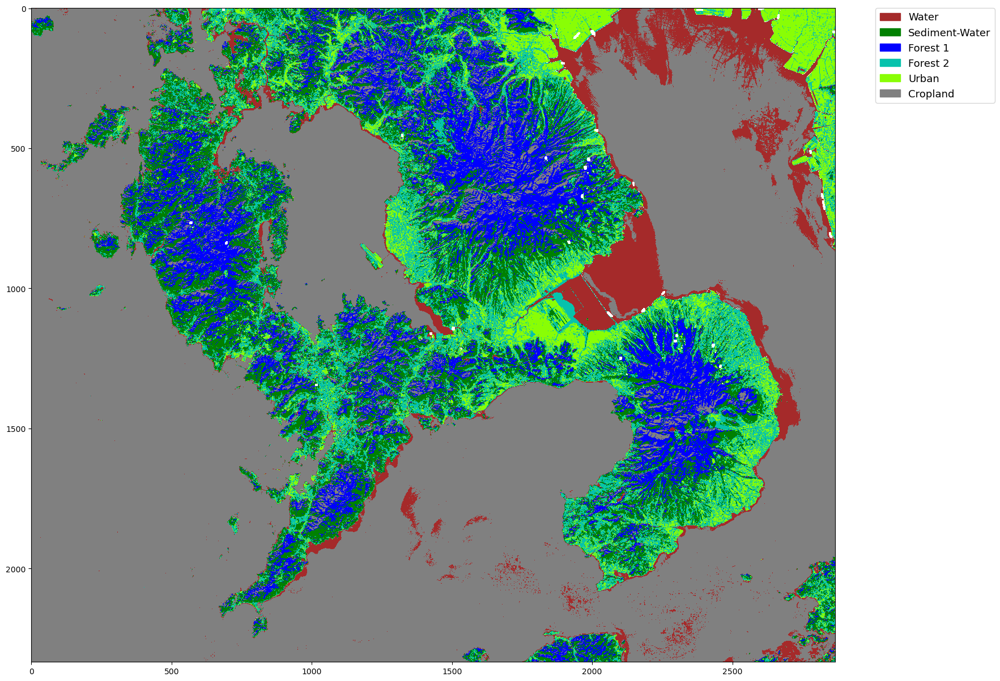

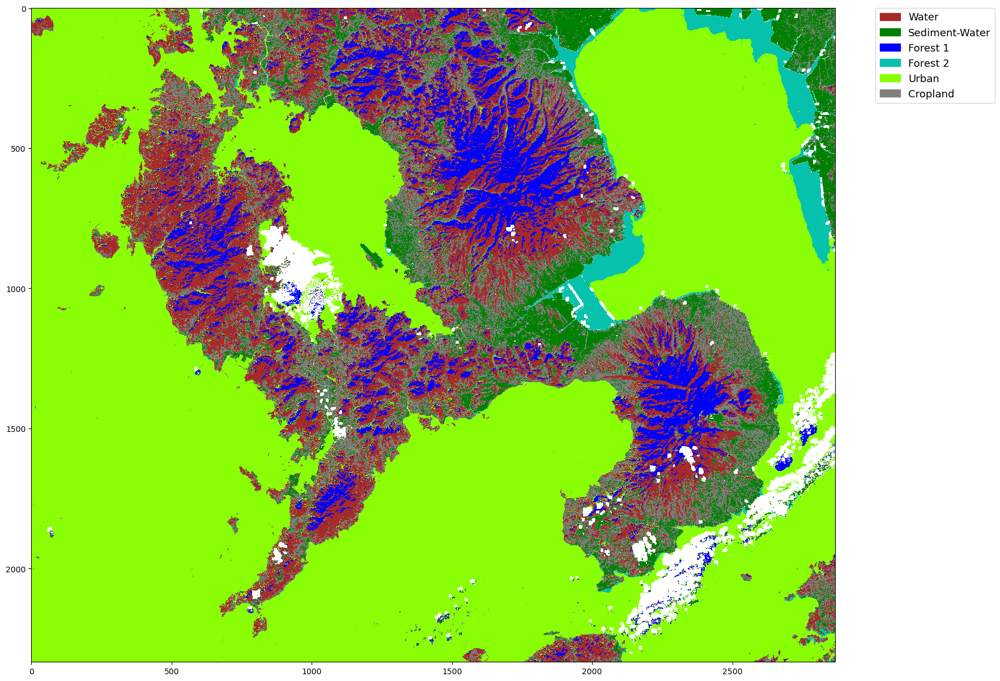

In [130]:
# Now that we have a pretty good model, let's see if we can expand this to the other scenes.
# Unfortunately, it seems that, scene to scene, the atmospheric conditions differ enough for there to be major inconsistencies
# between each scene, especially when using a model trained off a single scene. 
folder_list = glob("LC08*")

landuse_dict = {}

for folder in tqdm(folder_list):
    print(f"Generating Land Use for {folder}")
    
    stacked_mb_raster = glob(os.path.join(os.getcwd(), folder, '*_STACKED.tif'))
    qa_raster_path = glob(os.path.join(os.getcwd(), folder, '*QA*_crop.tif'))
    
    with rio.open(stacked_mb_raster[0]) as src:
        profile = src.profile
        stack = src.read()
        src.close()
        
    with rio.open(qa_raster_path[0]) as src:
        qa_raster = src.read(1)
        src.close()
        
    # change the stack from DNs to reflectances
    scaled_stack = stack[:-1,...] * 0.0000275 - 0.2
    scaled_temp = stack[-1,...] * 0.00341802 + 149.0 # remember temperature uses a different scaling factor (temp is in Kelvin)

    scaled_stack = np.vstack((scaled_stack, np.expand_dims(scaled_temp, axis = 0))) # need to change scaled_temp from 2D to 3D
    
    # classify the QA raster using conservative cloud estimates
    unique_vals = np.unique(qa_raster)
    masked_vals = apply_array_func(qa_pixel_interp_conservative, unique_vals)
    masked_vals = unique_vals[masked_vals]
    cl_mask = np.isin(qa_raster, masked_vals)
    
    # Train model
    training = scaled_stack[:, 500:1000, 1750:2250]
    new_shape = (training.shape[1] * training.shape[2], training.shape[0])
    X = training.swapaxes(0,2).reshape(new_shape)
    X_cluster = pipeline6.fit_predict(X)
    
    # Prepare data for ML prediction
    new_shape = (scaled_stack.shape[1] * scaled_stack.shape[2], scaled_stack.shape[0])
    X_test = scaled_stack.swapaxes(0,2).reshape(new_shape)
    
    # Get the predicted labels for the new training area
    X_test_cluster = pipeline6.predict(X_test)

    # Reshape into a proper coordinate grid
    X_test_cluster = X_test_cluster.reshape(scaled_stack.shape[2],scaled_stack.shape[1]).T
    
    # Add the cloud_mask to the image
    X_masked = np.ma.masked_array(X_test_cluster, cl_mask)
    
    # Store the masked array into the dictionary
    landuse_dict[folder] = X_masked
    
    # Save a copy of the image
    fig, ax = plt.subplots(figsize = (20,15))
    
    # ax.axis('off') # uncomment if you don't want axes - axes useful for slicing numpy arrays
    i = ax.imshow(X_masked, cmap = map_cmap, interpolation = "nearest")
    ep.draw_legend(im_ax = i, titles = [landuse_map[key] for key in landuse_map.keys()], cmap = legend_cmap)
    
    out_path = os.path.join(folder, f'{folder.split("_")[3]}_landuse.png')
    plt.savefig(out_path, dpi=300, bbox_inches='tight')

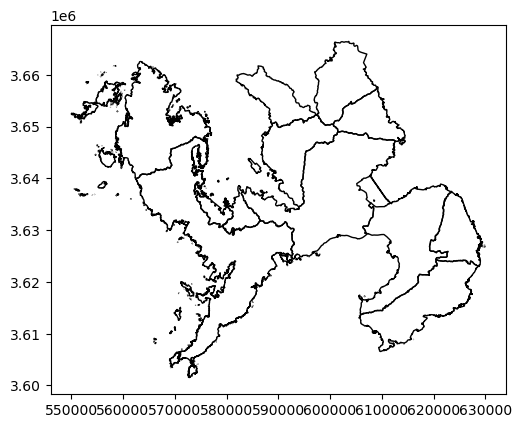

In [142]:
mun_bounds = gpd.read_file("mun_bounds_cleaned.geojson")

mun_bounds = mun_bounds.to_crs("EPSG:32652")

mun_bounds.plot(edgecolor = "black", color = "none")

boundary = mun_bounds["geometry"].to_list()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


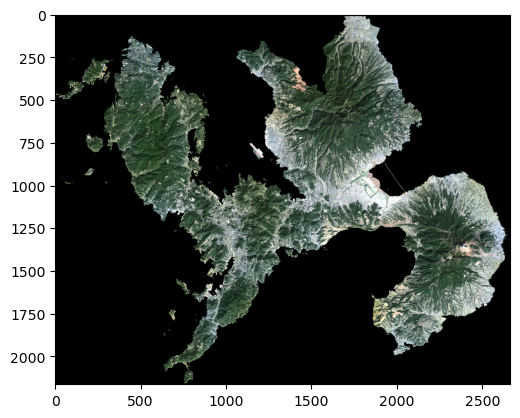

<Axes: >

In [159]:
# Another potential solution is to only train on the land - this may be useful if you want to only track landuse changes 
# and don't care about the oceans
from rasterio.mask import mask

with rio.open("LC08_L2SP_113037_20210104_20210308_02_T1/LC08_L2SP_113037_20210104_20210308_02_T1_STACKED.tif") as src:
    profile = src.profile
    
    # Note that crop = True crops the raster - all pixels outside the boundary are set to the nodata value
    # boundary is a list of shapefiles - if you only have one shapefile, you will need to put [] around it
    stack, out_transform = mask(src, boundary, crop=True)
    src.close()
    
# change the stack from DNs to reflectances
scaled_stack = stack[:-1,...] * 0.0000275 - 0.2
scaled_temp = stack[-1,...] * 0.00341802 + 149.0 # remember temperature uses a different scaling factor (temp is in Kelvin)

scaled_stack = np.vstack((scaled_stack, np.expand_dims(scaled_temp, axis = 0))) # need to change scaled_temp from 2D to 3D

# Conduct a histogram stretch of the study area
stretch_tcc = histogram_stretch(scaled_stack[[3,2,1], ...])

# View the chosen study area
show(stretch_tcc)

7it [02:11, 18.76s/it]


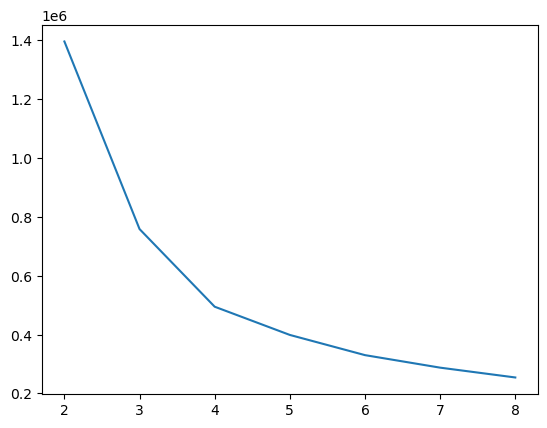

In [160]:
# sklearn is not robust enough to know about missing values - unfortunately, the nodata values will be given a class number. 
# thankfully, it's relatively simple to mask that class

new_shape = (scaled_stack.shape[1] * scaled_stack.shape[2], scaled_stack.shape[0])
X = scaled_stack.swapaxes(0,2).reshape(new_shape)

X_scaled = scaler.fit_transform(X)

inertia = np.empty(7)
num_clusters = [i for i in range(2,9)]

for i, number in enumerate(tqdm(num_clusters)):
    k_means = cluster.KMeans(n_clusters = number, random_state = 42, n_init = 10) # default clusters is 8
    k_means.fit(X_scaled)
    inertia[i] = k_means.inertia_

# Elbow plot suggests that n_clusters = 3 or 4 is a good choice
plt.plot(num_clusters, inertia)
plt.show()

In [165]:
pipeline4 = make_pipeline(StandardScaler(), cluster.KMeans(n_clusters = 5, n_init = 10))

X_labels = pipeline4.fit_predict(X)

# Because the corner of the image is always nodata, we can use that as a mask
X_labels = X_labels.reshape(scaled_stack.shape[2],scaled_stack.shape[1]).T

X_labels

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


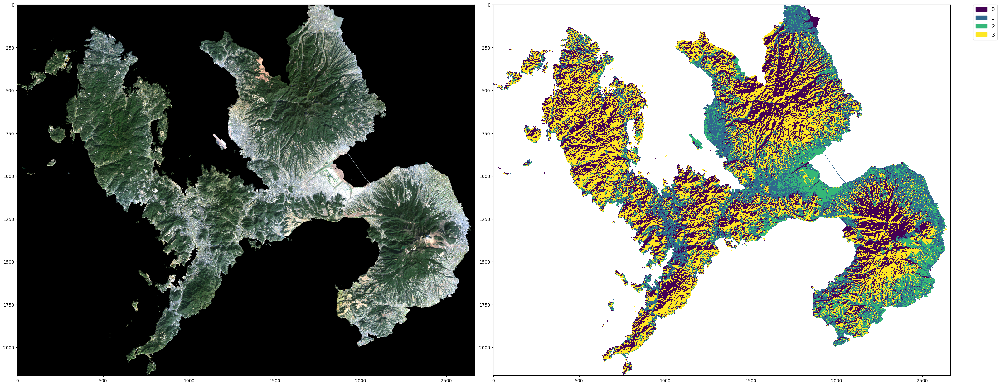

In [167]:
X_labels = np.ma.masked_array(X_labels, X_labels == 0)

fig, ax = plt.subplots(1,2, figsize = (32,18))

i = ax[1].imshow(X_labels, cmap = "viridis", interpolation = "nearest")

show(stretch_tcc, ax = ax[0])

ep.draw_legend(im_ax = i, titles = [i for i in range(4)], cmap = "viridis")

plt.tight_layout()

In [190]:
# Prepare a dictionary for the above classes
landuse_map = {
    0: "Forest 1",
    1: "Forest 2",
    2: "Urban",
    3: "Cropland"
}

from matplotlib.colors import ListedColormap

# Set up dictionary for legend map
colors = dict((
    (0, "xkcd:lime green"),   
    (1, "green"),   
    (2, "grey"),     
    (3, "brown")
))

legend_cmap = ListedColormap(["xkcd:lime green", "green", "grey", "brown"])

# Set up dictionary for map map
colors = dict((
    (1, "green"),   
    (2, "grey"),   
    (3, "brown"),     
    (4, "xkcd:lime green")
))

map_cmap = ListedColormap([colors[key] for key in colors], name = "map_colormap")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


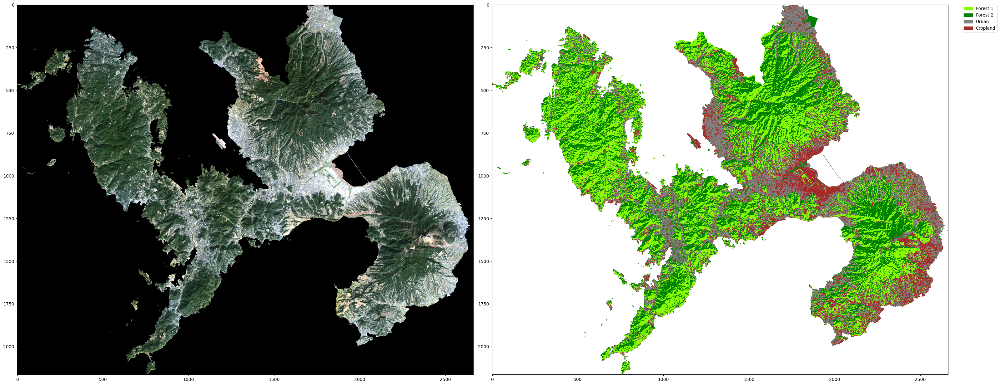

In [196]:
fig, ax = plt.subplots(1,2, figsize = (32,18))

i = ax[1].imshow(X_labels, cmap = map_cmap, interpolation = "nearest")

show(stretch_tcc, ax = ax[0])

# ep.draw_legend(im_ax = i, titles = [landuse_map[key] for key in range(len(np.unique(X_labels)) - 1)], cmap = legend_cmap)

# Manual addition of colorbar
colors = ["xkcd:lime green", "green", "grey", "brown"]
patches = [mpatches.Patch(color=colors[i], label = landuse_map[i]) for i in range(len(np.unique(X_labels)) - 1) ]
plt.legend(handles=patches, bbox_to_anchor=(1.03, 1), loc=2, borderaxespad=0. )

plt.tight_layout()

100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:37<00:00,  5.43s/it]


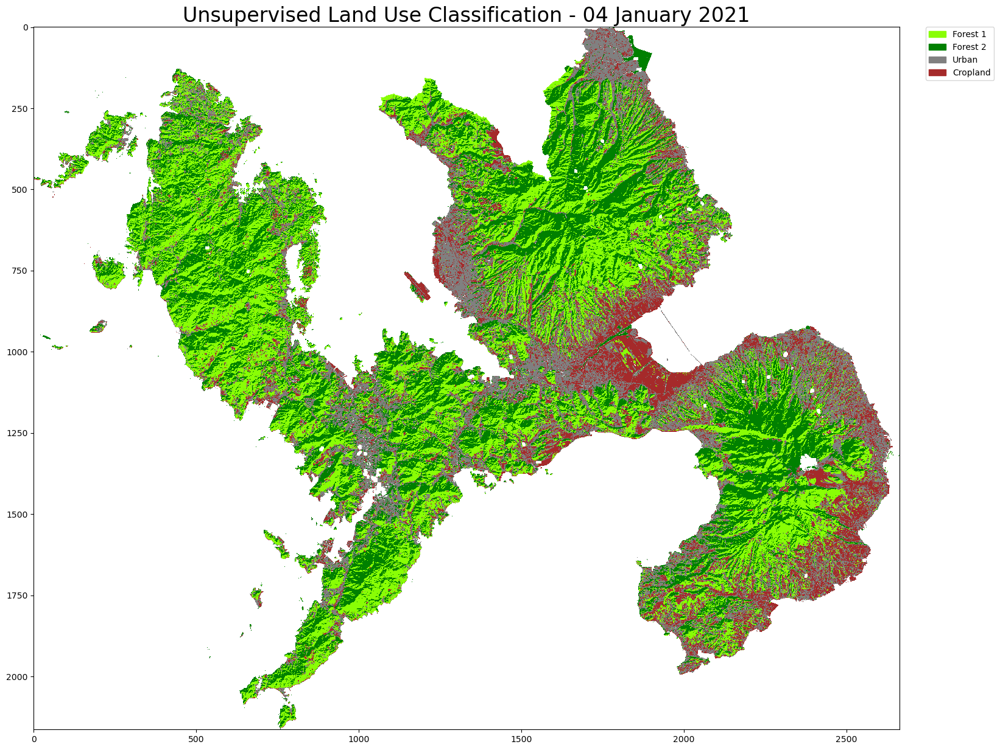

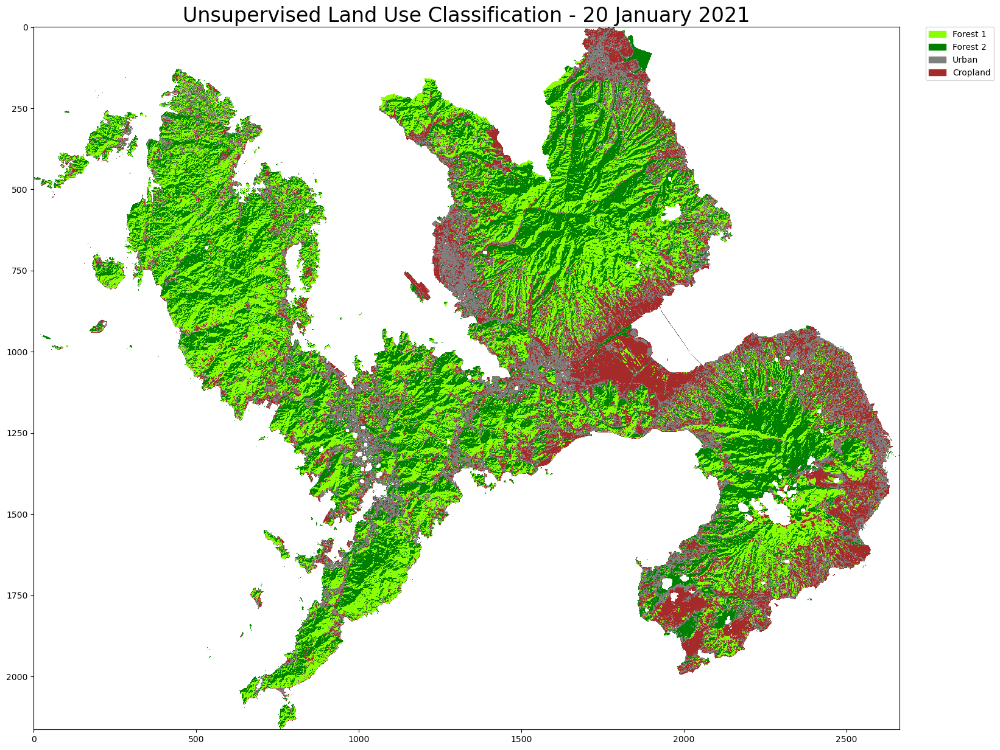

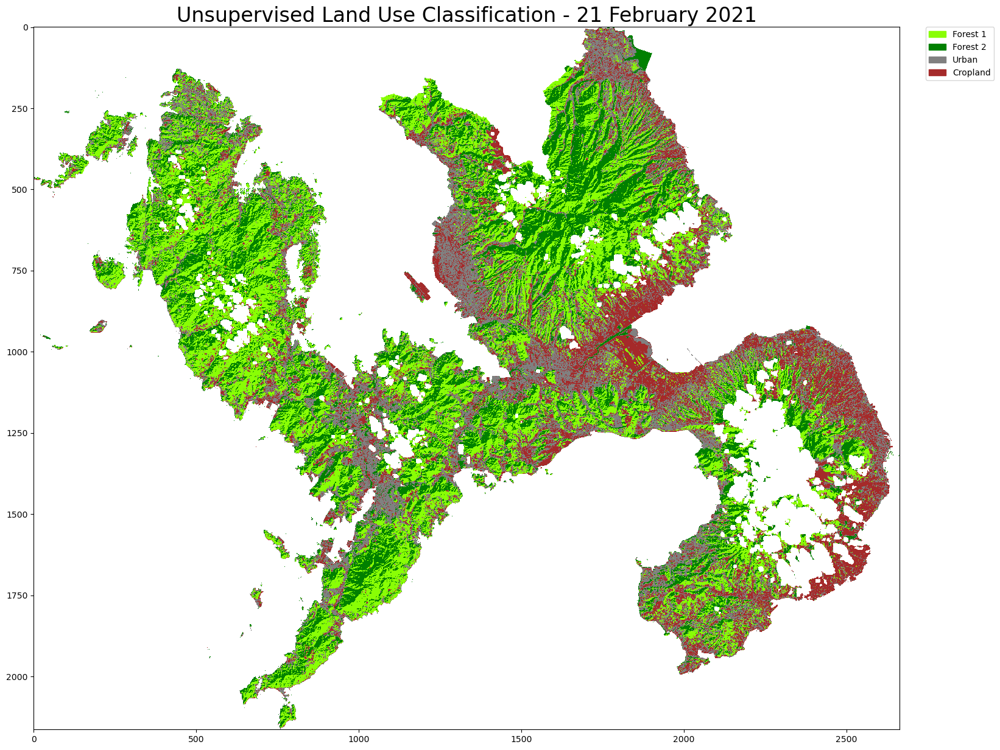

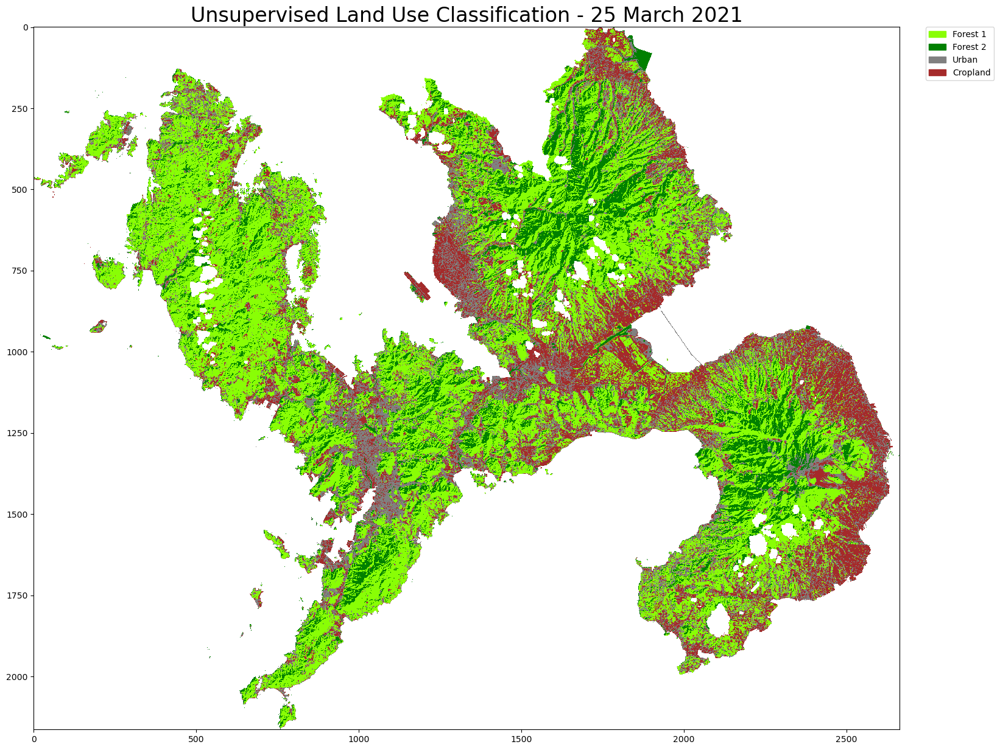

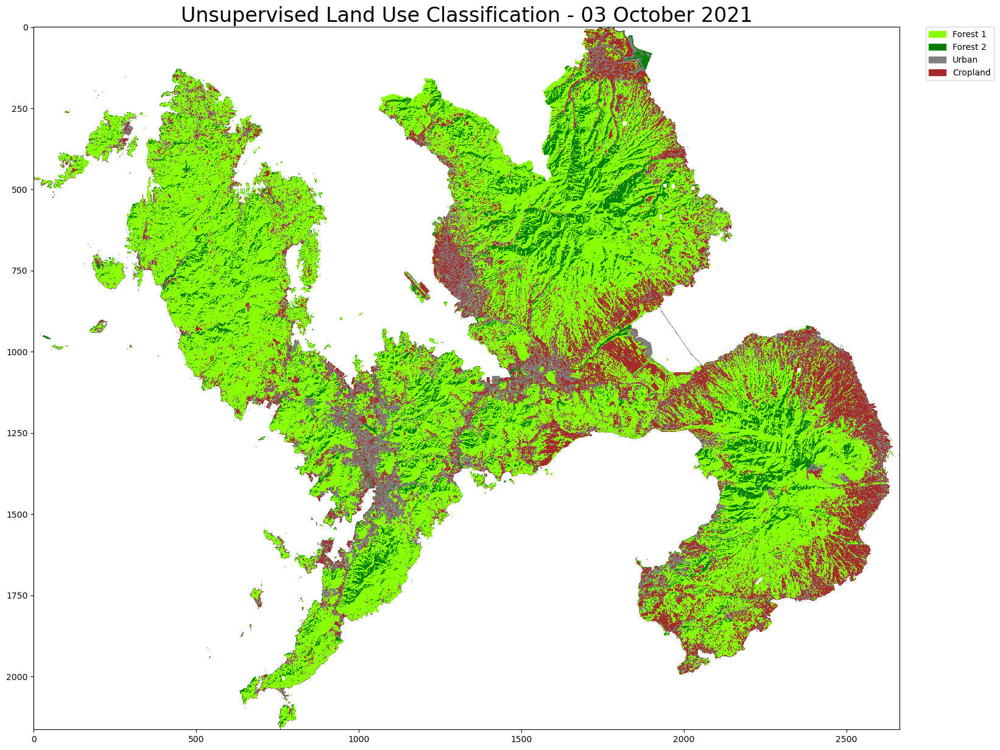

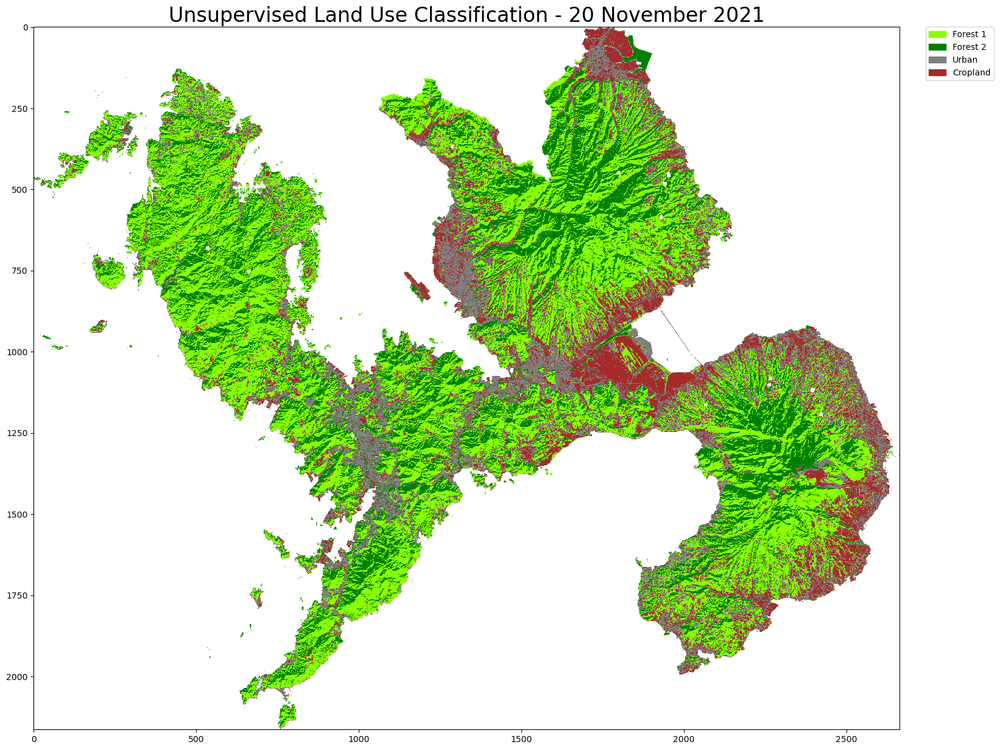

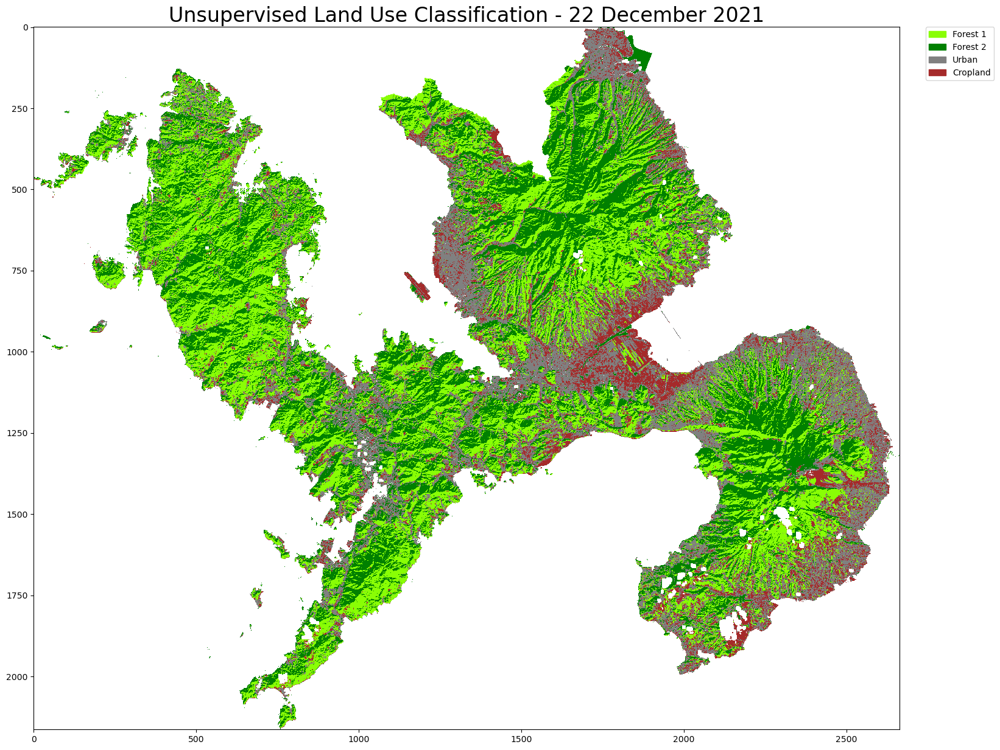

In [202]:
# Let's attempt to do this using our new workflow
folder_list = glob("LC08*")

landuse_dict = {}

for folder in tqdm(folder_list):
    
    stacked_mb_raster = glob(os.path.join(os.getcwd(), folder, '*_STACKED.tif'))
    qa_raster_path = glob(os.path.join(os.getcwd(), folder, '*QA*_crop.tif'))
    
    with rio.open(stacked_mb_raster[0]) as src:
        profile = src.profile

        # Note that crop = True crops the raster - all pixels outside the boundary are set to the nodata value
        # boundary is a list of shapefiles - if you only have one shapefile, you will need to put [] around it
        stack, out_transform = mask(src, boundary, crop=True)
        src.close()
        
    with rio.open(qa_raster_path[0]) as src:
        qa_raster, out_transform = mask(src, boundary, crop=True)
        src.close()
        
    # change the stack from DNs to reflectances
    scaled_stack = stack[:-1,...] * 0.0000275 - 0.2
    scaled_temp = stack[-1,...] * 0.00341802 + 149.0 # remember temperature uses a different scaling factor (temp is in Kelvin)

    scaled_stack = np.vstack((scaled_stack, np.expand_dims(scaled_temp, axis = 0))) # need to change scaled_temp from 2D to 3D
    
    # classify the QA raster using conservative cloud estimates
    unique_vals = np.unique(qa_raster)
    masked_vals = apply_array_func(qa_pixel_interp_conservative, unique_vals)
    masked_vals = unique_vals[masked_vals]
    cl_mask = np.isin(qa_raster, masked_vals)
    
    # Prepare data for ML prediction
    new_shape = (scaled_stack.shape[1] * scaled_stack.shape[2], scaled_stack.shape[0])
    X_test = scaled_stack.swapaxes(0,2).reshape(new_shape)
    
    # Get the predicted labels for the new training area
    X_test_cluster = pipeline4.predict(X_test)

    # Reshape into a proper coordinate grid
    X_test_cluster = X_test_cluster.reshape(scaled_stack.shape[2],scaled_stack.shape[1]).T
    
    # Add the cloud_mask to the image, also mask nodata class
    X_masked = np.ma.masked_array(X_test_cluster, (X_test_cluster == 0) | (cl_mask))
    
    # Store the masked array into the dictionary
    landuse_dict[folder] = X_masked
    
    # Save a copy of the image
    fig, ax = plt.subplots(figsize = (20,15))
    
    # ax.axis('off') # uncomment if you don't want axes - axes useful for slicing numpy arrays
    i = ax.imshow(X_masked, cmap = map_cmap, interpolation = "nearest")
    colors = ["xkcd:lime green", "green", "grey", "brown"]
    patches = [mpatches.Patch(color=colors[i], label = landuse_map[i]) for i in range(len(np.unique(X_labels)) - 1) ]
    plt.legend(handles=patches, bbox_to_anchor=(1.03, 1), loc=2, borderaxespad=0. )
    
    # Convert date to a datetime object
    date_obj = datetime.strptime(folder.split("_")[3], "%Y%m%d")

    # Format the date as "10th November 2022"
    formatted_date = date_obj.strftime("%d %B %Y")
    
    ax.set_title(f"Unsupervised Land Use Classification - {formatted_date}", fontsize = 24)
    
    out_path = os.path.join(folder, f'{folder.split("_")[3]}_cropped_landuse.png')
    plt.savefig(out_path, dpi=300, bbox_inches='tight')

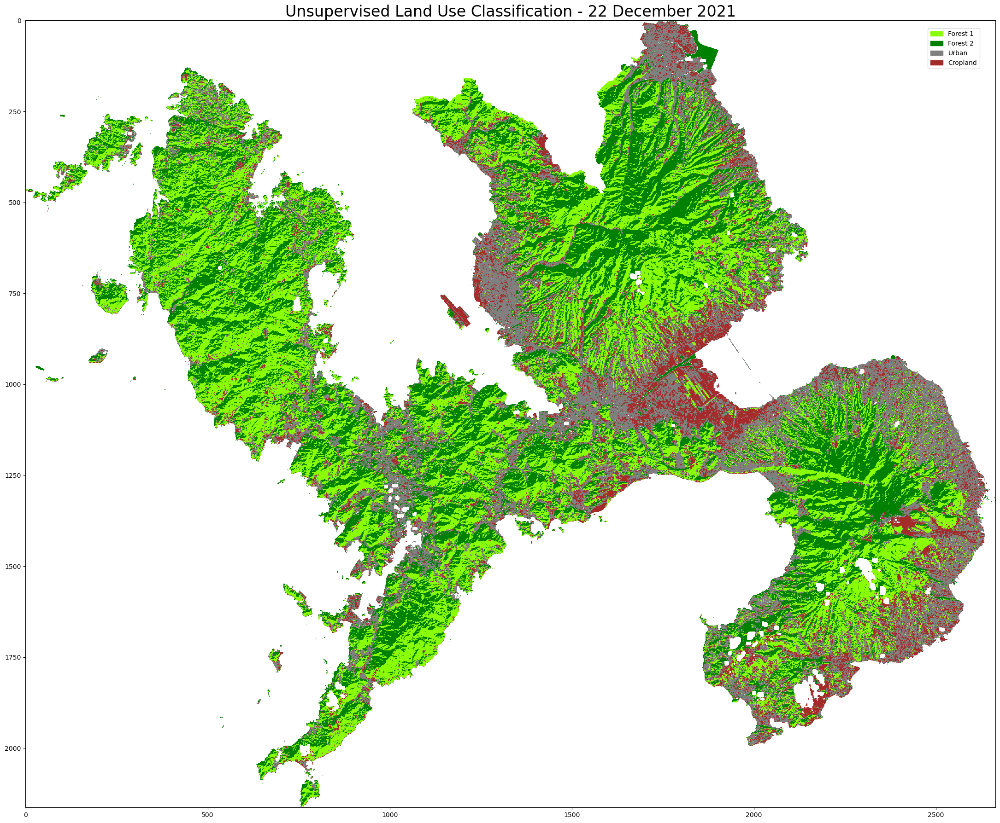

In [214]:
# Create an animation
# That looks pretty good! There are still some issues, such as some cropland being mistaken for forest,
# especially during harvest time, but this is still a relatively good attempt for an unsupervised learning method

# Some potential improvements could be to get data for the remaining 5 months of the year (the summer months) to get a full, 
# year-round land-use change analysis
from matplotlib.animation import FuncAnimation

fig, ax = plt.subplots(figsize = (23,18))

landuse_plot = ax.imshow(landuse_dict[folder_list[0]], cmap = map_cmap, interpolation = "nearest")
colors = ["xkcd:lime green", "green", "grey", "brown"]
patches = [mpatches.Patch(color=colors[i], label = landuse_map[i]) for i in range(len(np.unique(X_labels)) - 1) ]
plt.legend(handles=patches, bbox_to_anchor=(0.93, 0.99), loc=2, borderaxespad=0. )

def update(frame):
    scene = folder_list[frame]
    
    landuse_plot.set_data(landuse_dict[scene])
    
    # Convert date to a datetime object
    date_obj = datetime.strptime(scene.split("_")[3], "%Y%m%d")

    # Format the date as "10th November 2022"
    formatted_date = date_obj.strftime("%d %B %Y")
    
    ax.set_title(f"Unsupervised Land Use Classification - {formatted_date}", fontsize = 24)

animation = FuncAnimation(fig, update, frames=len(landuse_dict), repeat=True, interval = 1000)
plt.subplots_adjust(
    top=0.97,
    bottom=0.02,
    left=-0.01,
    right=1.01,
    hspace=0.1,
    wspace=0.1
)

# Save the animation
animation_file = f'unsupervised_landuse_seasonal.gif'
animation.save(animation_file, writer='pillow')

plt.show()

In [215]:
from joblib import dump, load

dump(pipeline4, 'unsupervised_learning_cropped_dataset_4cluster.joblib') 

['unsupervised_learning_cropped_dataset_4cluster.joblib']

In [155]:
### SOME WORKING FOR MASKED ARRAYS AND HOW THEY INTERACT WITH SKLEARN

masked_stack = np.ma.masked_array(scaled_stack, (scaled_stack == -0.2) | (scaled_stack == 149))

new_shape = (masked_stack.shape[1] * masked_stack.shape[2], masked_stack.shape[0])
test = masked_stack.swapaxes(0,2).reshape(new_shape)


test_results = pipeline6.fit_predict(test)

test_results

array([1, 1, 1, ..., 1, 1, 1])

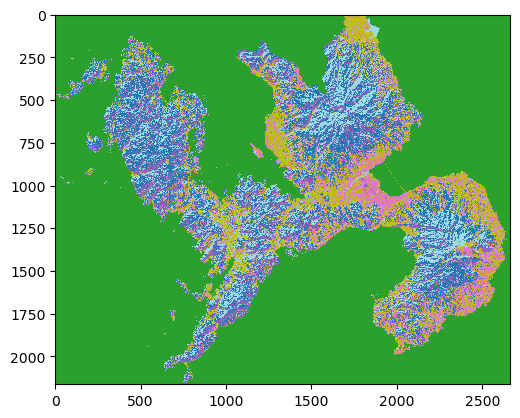

In [156]:
test_results_reshaped = test_results.reshape(masked_stack.shape[2],masked_stack.shape[1]).T

plt.imshow(test_results_reshaped, cmap = "tab20", interpolation = "nearest")

In [200]:
from datetime import datetime